## Inputs

In [89]:
#Importing the packages
import os
import numpy as np
import matplotlib.pyplot as plt
import cv2
import tensorflow as tf
from tensorflow.keras.layers import Input,Conv2D,Activation,BatchNormalization,Add,Multiply,Concatenate,GlobalAveragePooling2D
from tensorflow.keras.utils import plot_model
from tensorflow.keras.models import Model
import datetime
import pandas as pd
import time

In [ ]:
#Getting the filepaths for train and test data
train_files=['data/patches/train/'+filename for filename in os.listdir('data/patches/train')]
test_files=['data/patches/test/'+filename for filename in os.listdir('data/patches/test')]

In [ ]:
def _parse_function(filename):
    '''This function performs adding noise to the image given by Dataset'''
    image_string = tf.io.read_file(filename)
    image_decoded = tf.image.decode_jpeg(image_string, channels=3)
    image = tf.cast(image_decoded, tf.float32)/255.

    noise_level=np.random.choice(NOISE_LEVELS)
    noisy_image=image+tf.random.normal(shape=(40,40,3),mean=0,stddev=noise_level/255)
    noisy_image=tf.clip_by_value(noisy_image, clip_value_min=0., clip_value_max=1.)

    return noisy_image,image

In [ ]:
BATCH_SIZE=64
NOISE_LEVELS=[15,25,50] 

#Creating the Dataset
train_dataset = tf.data.Dataset.from_tensor_slices(np.array(train_files)) 
train_dataset = train_dataset.map(_parse_function)
train_dataset = train_dataset.batch(BATCH_SIZE)

test_dataset = tf.data.Dataset.from_tensor_slices(np.array(test_files))
test_dataset = test_dataset.map(_parse_function)
test_dataset = test_dataset.batch(BATCH_SIZE)

In [ ]:
iterator = iter(train_dataset)
a, b = iterator.get_next()

print('Shape of single batch of x : ',a.shape)
print('Shape of single batch of y : ',b.shape)

Shape of single batch of x :  (64, 40, 40, 3)
Shape of single batch of y :  (64, 40, 40, 3)


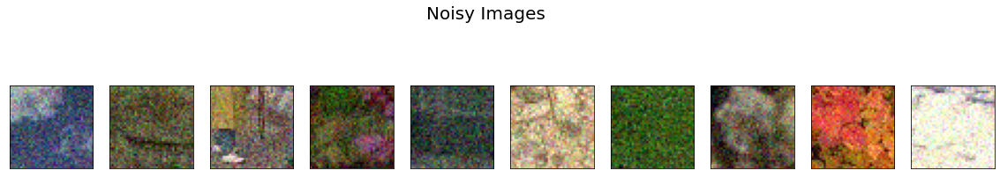

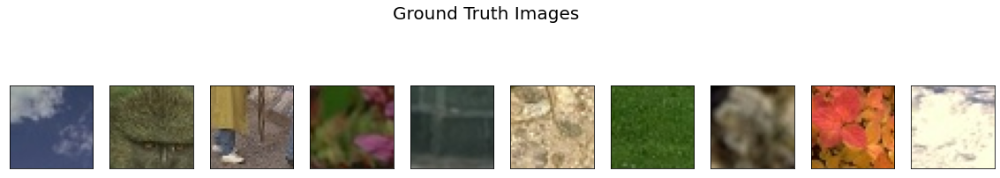

In [ ]:
#Plotting the images from dataset to verify the dataset
fig, axs = plt.subplots(1,10,figsize=(20,4))
for i in range(10):
  axs[i].imshow(a[i])
  axs[i].get_xaxis().set_visible(False)
  axs[i].get_yaxis().set_visible(False)
fig.suptitle('Noisy Images',fontsize=20)
plt.show()
fig, axs = plt.subplots(1,10,figsize=(20,4))
for i in range(10):
  axs[i].imshow(b[i])
  axs[i].get_xaxis().set_visible(False)
  axs[i].get_yaxis().set_visible(False)
fig.suptitle('Ground Truth Images',fontsize=20)
plt.show()

## Helper functions

In [ ]:
def get_patches(file_name,patch_size,crop_sizes):
    '''This functions creates and return patches of given image with a specified patch_size'''
    image = cv2.imread(file_name) 
    image=cv2.cvtColor(image,cv2.COLOR_BGR2RGB)
    height, width , channels= image.shape
    patches = []
    for crop_size in crop_sizes: #We will crop the image to different sizes
        crop_h, crop_w = int(height*crop_size),int(width*crop_size)
        image_scaled = cv2.resize(image, (crop_w,crop_h), interpolation=cv2.INTER_CUBIC)
        for i in range(0, crop_h-patch_size+1, patch_size):
            for j in range(0, crop_w-patch_size+1, patch_size):
              x = image_scaled[i:i+patch_size, j:j+patch_size] # This gets the patch from the original image with size patch_size x patch_size
              patches.append(x)
    return patches

def create_image_from_patches(patches,image_shape):
  '''This function takes the patches of images and reconstructs the image'''
  image=np.zeros(image_shape) # Create a image with all zeros with desired image shape
  patch_size=patches.shape[1]
  p=0
  for i in range(0,image.shape[0]-patch_size+1,patch_size):
    for j in range(0,image.shape[1]-patch_size+1,patch_size):
      image[i:i+patch_size,j:j+patch_size]=patches[p] # Assigning values of pixels from patches to image
      p+=1
  return np.array(image)

def predict_fun(model,image_path,noise_level=30):
  #Creating patches for test image
  patches=get_patches(image_path,40,[1])
  test_image=cv2.imread(image_path)

  patches=np.array(patches)
  ground_truth=create_image_from_patches(patches,test_image.shape)

  #predicting the output on the patches of test image
  patches = patches.astype('float32') /255.
  patches_noisy = patches+ tf.random.normal(shape=patches.shape,mean=0,stddev=noise_level/255) 
  patches_noisy = tf.clip_by_value(patches_noisy, clip_value_min=0., clip_value_max=1.)
  noisy_image=create_image_from_patches(patches_noisy,test_image.shape)

  denoised_patches=model.predict(patches_noisy)
  denoised_patches=tf.clip_by_value(denoised_patches, clip_value_min=0., clip_value_max=1.)

  #Creating entire denoised image from denoised patches
  denoised_image=create_image_from_patches(denoised_patches,test_image.shape)

  return patches_noisy,denoised_patches,ground_truth/255.,noisy_image,denoised_image


def plot_patches(patches_noisy,denoised_patches):
  fig, axs = plt.subplots(2,10,figsize=(20,4))
  for i in range(10):

    axs[0,i].imshow(patches_noisy[i])
    axs[0,i].title.set_text(' Noisy')
    axs[0,i].get_xaxis().set_visible(False)
    axs[0,i].get_yaxis().set_visible(False)

    axs[1,i].imshow(denoised_patches[i])
    axs[1,i].title.set_text('Denoised')
    axs[1,i].get_xaxis().set_visible(False)
    axs[1,i].get_yaxis().set_visible(False)
  plt.show()

def plot_predictions(ground_truth,noisy_image,denoised_image):
  fig, axs = plt.subplots(1,3,figsize=(15,15))
  axs[0].imshow(ground_truth)
  axs[0].title.set_text('Ground Truth')
  axs[1].imshow(noisy_image)
  axs[1].title.set_text('Noisy Image')
  axs[2].imshow(denoised_image)
  axs[2].title.set_text('Denoised Image')
  plt.show()


#https://www.geeksforgeeks.org/python-peak-signal-to-noise-ratio-psnr/
def PSNR(gt, image, max_value=1):
    """"Function to calculate peak signal-to-noise ratio (PSNR) between two images."""
    mse = np.mean((gt - image) ** 2)
    if mse == 0:
        return 100
    return 20 * np.log10(max_value / (np.sqrt(mse)))

## RIDNET

In [ ]:
def EAM(input):

  x=Conv2D(64, (3,3), dilation_rate=1,padding='same',activation='relu')(input)
  x=Conv2D(64, (3,3), dilation_rate=2,padding='same',activation='relu')(x)

  y=Conv2D(64, (3,3), dilation_rate=3,padding='same',activation='relu')(input)
  y=Conv2D(64, (3,3), dilation_rate=4,padding='same',activation='relu')(y)

  z=Concatenate(axis=-1)([x,y])
  z=Conv2D(64, (3,3),padding='same',activation='relu')(z)
  add_1=Add()([z, input])

  z=Conv2D(64, (3,3),padding='same',activation='relu')(add_1)
  z=Conv2D(64, (3,3),padding='same')(z)
  add_2=Add()([z,add_1])
  add_2 = Activation('relu')(add_2)

  z=Conv2D(64, (3,3),padding='same',activation='relu')(add_2)
  z=Conv2D(64, (3,3),padding='same',activation='relu')(z)
  z=Conv2D(64, (1,1),padding='same')(z)
  add_3=Add()([z,add_2])
  add_3 = Activation('relu')(add_3)

  z = GlobalAveragePooling2D()(add_3)
  z = tf.expand_dims(z,1)
  z = tf.expand_dims(z,1)
  z=Conv2D(4, (3,3),padding='same',activation='relu')(z)
  z=Conv2D(64, (3,3),padding='same',activation='sigmoid')(z)
  mul=Multiply()([z, add_3])

  return mul

In [ ]:
def RIDNET():

  input = Input((40, 40, 3),name='input')
  feat_extraction =Conv2D(64, (3,3),padding='same')(input)
  eam_1=EAM(feat_extraction)
  eam_2=EAM(eam_1)
  eam_3=EAM(eam_2)
  eam_4=EAM(eam_3)
  x=Conv2D(3, (3,3),padding='same')(eam_4)
  add_2=Add()([x, input])
  
  model=Model(input,add_2)

  return model

In [ ]:
tf.keras.backend.clear_session()
tf.random.set_seed(6908)
ridnet = RIDNET()

In [ ]:
ridnet.compile(optimizer=tf.keras.optimizers.Adam(1e-03), loss=tf.keras.losses.MeanAbsoluteError())

In [62]:
ridnet.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input (InputLayer)              [(None, 40, 40, 3)]  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 40, 40, 64)   1792        input[0][0]                      
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 40, 40, 64)   36928       conv2d[0][0]                     
__________________________________________________________________________________________________
conv2d_3 (Conv2D)               (None, 40, 40, 64)   36928       conv2d[0][0]                     
______________________________________________________________________________________________

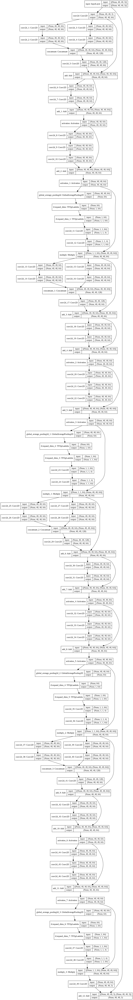

In [63]:
plot_model(ridnet,show_shapes=True,to_file='ridnet.png')

In [ ]:
def scheduler(epoch,lr):
  return lr*0.9

In [42]:
checkpoint_path = "ridnet.h5" # For each epoch creaking a checkpoint
checkpoint_dir = os.path.dirname(checkpoint_path)
cp_callback = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_path,save_weights_only=False,verbose=0,save_best_only=False) # To save the model if the metric is improved

# Tensorbaord 
! rm -rf ./logs_ridnet/  # Removing all the files present in the directory
logdir = os.path.join("logs_ridnet", datetime.datetime.now().strftime("%Y%m%d-%H%M%S")) # Directory for storing the logs that are required for tensorboard
%reload_ext  tensorboard
%tensorboard --logdir $logdir
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

lrScheduler = tf.keras.callbacks.LearningRateScheduler(scheduler)

callbacks = [cp_callback,tensorboard_callback,lrScheduler]
ridnet.fit( train_dataset,shuffle=True,epochs=10,validation_data= test_dataset,callbacks=callbacks)

<IPython.core.display.Javascript object>

Epoch 1/10
1338/1338 [==============================] - 154s 112ms/step - loss: 0.0372 - val_loss: 0.0228
Epoch 2/10
1338/1338 [==============================] - 148s 110ms/step - loss: 0.0234 - val_loss: 0.0229
Epoch 3/10
1338/1338 [==============================] - 148s 110ms/step - loss: 0.0228 - val_loss: 0.0225
Epoch 4/10
1338/1338 [==============================] - 148s 111ms/step - loss: 0.0226 - val_loss: 0.0220
Epoch 5/10
1338/1338 [==============================] - 148s 110ms/step - loss: 0.0224 - val_loss: 0.0226
Epoch 6/10
1338/1338 [==============================] - 148s 111ms/step - loss: 0.0222 - val_loss: 0.0220
Epoch 7/10
1338/1338 [==============================] - 148s 111ms/step - loss: 0.0221 - val_loss: 0.0225
Epoch 8/10
1338/1338 [==============================] - 148s 111ms/step - loss: 0.0220 - val_loss: 0.0223
Epoch 9/10
1338/1338 [==============================] - 148s 111ms/step - loss: 0.0220 - val_loss: 0.0223
Epoch 10/10
1338/1338 [=======================

In [55]:
ridnet.fit( train_dataset,shuffle=True,epochs=20,initial_epoch=10,validation_data= test_dataset,callbacks=callbacks)

Epoch 11/20
1338/1338 [==============================] - 149s 111ms/step - loss: 0.0218 - val_loss: 0.0226
Epoch 12/20
1338/1338 [==============================] - 148s 111ms/step - loss: 0.0218 - val_loss: 0.0222
Epoch 13/20
1338/1338 [==============================] - 148s 111ms/step - loss: 0.0218 - val_loss: 0.0223
Epoch 14/20
1338/1338 [==============================] - 148s 111ms/step - loss: 0.0217 - val_loss: 0.0223
Epoch 15/20
1338/1338 [==============================] - 148s 111ms/step - loss: 0.0217 - val_loss: 0.0221
Epoch 16/20
1338/1338 [==============================] - 148s 111ms/step - loss: 0.0217 - val_loss: 0.0220
Epoch 17/20
1338/1338 [==============================] - 148s 111ms/step - loss: 0.0216 - val_loss: 0.0223
Epoch 18/20
1338/1338 [==============================] - 148s 111ms/step - loss: 0.0216 - val_loss: 0.0225
Epoch 19/20
1338/1338 [==============================] - 148s 111ms/step - loss: 0.0216 - val_loss: 0.0223
Epoch 20/20
1338/1338 [==============

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [47]:
!cp /content/ridnet.h5 /content/drive/MyDrive/CS2/

In [48]:
!cp -r /content/logs_ridnet /content/drive/MyDrive/CS2/

PSNR of Noisy Image :  20.5242639702969
PSNR of Denoised Image :  31.90438481748968


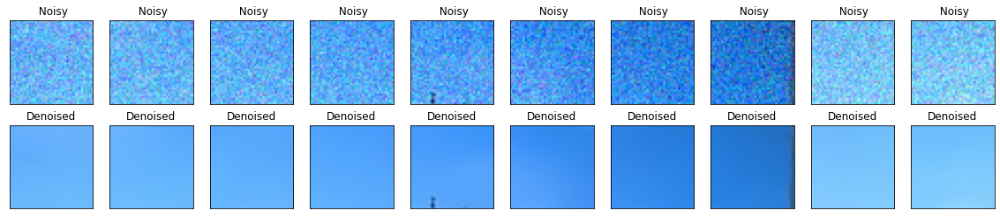

In [56]:
patches_noisy,denoised_patches,ground_truth,noisy_image,denoised_image=predict_fun(ridnet,'data/test/102061.jpg',noise_level=25)
print('PSNR of Noisy Image : ',PSNR(ground_truth,noisy_image))
print('PSNR of Denoised Image : ',PSNR(ground_truth,denoised_image))
plot_patches(patches_noisy,denoised_patches)

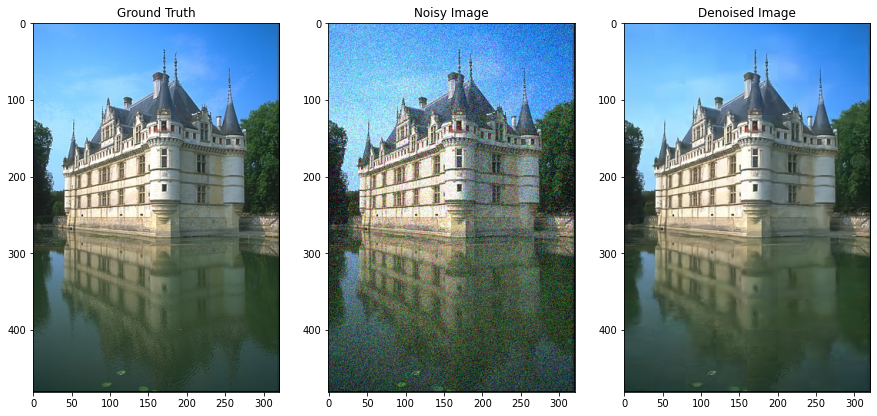

In [57]:
plot_predictions(ground_truth,noisy_image,denoised_image)

## Residual Learning

In [64]:
model_res=Model(ridnet.input,ridnet.get_layer('conv2d_49').output)

In [67]:
patches_noisy,denoised_patches,ground_truth,noisy_image,residual_image=predict_fun(model_res,'data/test/102061.jpg',noise_level=25)

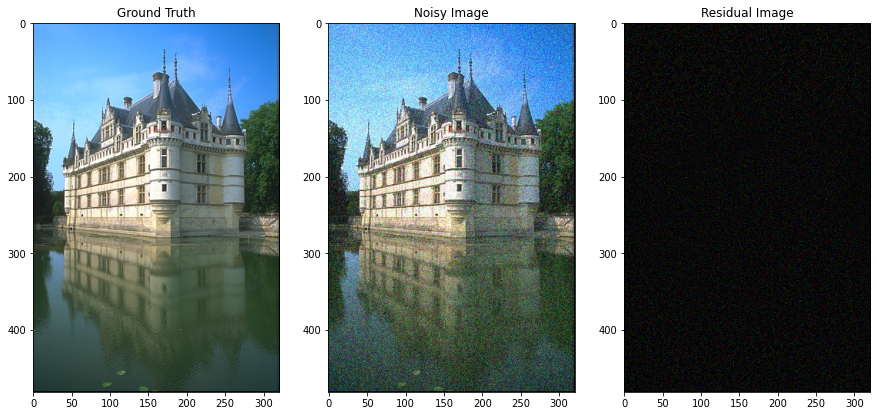

In [68]:
fig, axs = plt.subplots(1,3,figsize=(15,15))
axs[0].imshow(ground_truth)
axs[0].title.set_text('Ground Truth')
axs[1].imshow(noisy_image)
axs[1].title.set_text('Noisy Image')
axs[2].imshow(residual_image)
axs[2].title.set_text('Residual Image')
plt.show()

## Model Comparisions

In [69]:
dncnn=tf.keras.models.load_model('dncnn.h5')
autoencoder=tf.keras.models.load_model('autoencoder.h5')

In [73]:
results=pd.DataFrame(columns=['Noise Level','Noise Image','AutoEncoder','DnCNN','RIDNET'])

In [74]:
def get_results(results,noise_level):

  patches_noisy_a,denoised_patches_a,ground_truth,noisy_image_a,denoised_image_a=predict_fun(ridnet,'data/test/102061.jpg',noise_level=noise_level)
  patches_noisy_d,denoised_patches_d,ground_truth,noisy_image_d,denoised_image_d=predict_fun(dncnn,'data/test/102061.jpg',noise_level=noise_level)
  patches_noisy_r,denoised_patches_r,ground_truth,noisy_image_r,denoised_image_r=predict_fun(ridnet,'data/test/102061.jpg',noise_level=noise_level)
  results.loc[len(results.index)]=[noise_level,PSNR(ground_truth,noisy_image_a),PSNR(ground_truth,denoised_image_a)
                                                    ,PSNR(ground_truth,denoised_image_d),PSNR(ground_truth,denoised_image_r)]

  return results

In [75]:
results=get_results(results,15)
results=get_results(results,20)
results=get_results(results,25)
results=get_results(results,30)
results=get_results(results,40)
results=get_results(results,45)

In [76]:
print('Tabulating the model results with different noise level \n')
results.head(6)

Tabulating the model results with different noise level 



,Noise Level,Noise Image,AutoEncoder,DnCNN,RIDNET
0,15.0,24.845110,32.388158,32.270786,32.473852
1,20.0,22.390184,32.346889,31.923581,32.386050
2,25.0,20.512513,31.911771,31.159505,31.863160
3,30.0,19.020924,29.952373,29.618193,29.922082
4,40.0,16.713513,24.626888,24.878584,24.568452
5,45.0,15.823676,22.879885,23.087721,22.847336


<h3>
RIDNET is performing better than the Autoencoder and DnCNN models.
But the number trainable parameter in RidNET is comparatively higher than the other two models.
</h3>

## Model Quantization

In [97]:
#Loading the quantized model
dncnn_lite = tf.lite.Interpreter(f'dncnn.tflite')
dncnn_lite.allocate_tensors()

In [ ]:
#https://stackoverflow.com/questions/51966486/different-predictions-when-running-keras-model-in-tensorflow-lite
#https://www.tensorflow.org/lite/convert

converter = tf.lite.TFLiteConverter.from_keras_model(ridnet)

tflite_model = converter.convert()

In [104]:
with open(f'ridnet.tflite', 'wb') as ridnet_lite:
    ridnet_lite.write(tflite_model)

In [105]:
ridnet_lite = tf.lite.Interpreter(f'ridnet.tflite')
ridnet_lite.allocate_tensors()
i = ridnet_lite.get_input_details()[0]
o = ridnet_lite.get_output_details()[0]

In [106]:
def predict_fun_tflite(model,image_path,noise_level=30):
  #Creating patches for test image
  patches=get_patches(image_path,40,[1])
  test_image=cv2.imread(image_path)

  patches=np.array(patches)
  ground_truth=create_image_from_patches(patches,test_image.shape)

  #predicting the output on the patches of test image
  patches = patches.astype('float32') /255.
  patches_noisy = patches+ tf.random.normal(shape=patches.shape,mean=0,stddev=noise_level/255) 
  patches_noisy = tf.clip_by_value(patches_noisy, clip_value_min=0., clip_value_max=1.)
  noisy_image=create_image_from_patches(patches_noisy,test_image.shape)

  #model=allocate_batch_size(model,len(patches_noisy))
  #model.set_tensor(model.get_input_details()[0]['index'], patches_noisy)
  #model.invoke()
  
  denoised_patches=[]
  for p in patches_noisy:
    model.set_tensor(model.get_input_details()[0]['index'],tf.expand_dims(p,axis=0))
    model.invoke()
    pred=model.get_tensor(model.get_output_details()[0]['index'])
    pred=tf.squeeze(pred,axis=0)
    denoised_patches.append(pred)
  
  denoised_patches=np.array(denoised_patches)
  denoised_patches=tf.clip_by_value(denoised_patches, clip_value_min=0., clip_value_max=1.)

  #Creating entire denoised image from denoised patches
  denoised_image=create_image_from_patches(denoised_patches,test_image.shape)

  return patches_noisy,denoised_patches,ground_truth/255.,noisy_image,denoised_image

In [109]:
start=time.time()
patches_noisy,denoised_patches,ground_truth,noisy_image,denoised_image=predict_fun(dncnn,'data/test/223061.jpg',noise_level=25)
end=time.time()
time_taken=end-start
print('PSNR of Noisy Image : ',PSNR(ground_truth,noisy_image))
print('PSNR of denoised image using dncnn original model: %.3f db , Time taken : %.5f seconds'%(PSNR(ground_truth,denoised_image),time_taken))
print('================================================================================ \n')

start=time.time()
patches_noisy,denoised_patches,ground_truth,noisy_image,denoised_image=predict_fun_tflite(dncnn_lite,'data/test/223061.jpg',noise_level=25)
end=time.time()
time_taken=end-start
print('PSNR of Noisy Image : ',PSNR(ground_truth,noisy_image))
print('PSNR of denoised image using dncnn quantized model: %.3f db , Time taken : %.5f seconds'%(PSNR(ground_truth,denoised_image),time_taken))
print('================================================================================ \n')

start=time.time()
patches_noisy,denoised_patches,ground_truth,noisy_image,denoised_image=predict_fun(ridnet,'data/test/223061.jpg',noise_level=25)
end=time.time()
time_taken=end-start
print('PSNR of Noisy Image : ',PSNR(ground_truth,noisy_image))
print('PSNR of denoised image using ridnet original model: %.3f db , Time taken : %.5f seconds'%(PSNR(ground_truth,denoised_image),time_taken))
print('================================================================================ \n')

start=time.time()
patches_noisy,denoised_patches,ground_truth,noisy_image,denoised_image=predict_fun_tflite(ridnet_lite,'data/test/223061.jpg',noise_level=25)
end=time.time()
time_taken=end-start
print('PSNR of Noisy Image : ',PSNR(ground_truth,noisy_image))
print('PSNR of denoised image using ridnet quantized model: %.3f db , Time taken : %.5f seconds'%(PSNR(ground_truth,denoised_image),time_taken))
print('================================================================================ \n')


PSNR of Noisy Image :  20.412431757756252
PSNR of denoised image using dncnn original model: 29.380 db , Time taken : 0.12744 seconds

PSNR of Noisy Image :  20.415290455970037
PSNR of denoised image using dncnn quantized model: 29.389 db , Time taken : 3.45226 seconds

PSNR of Noisy Image :  20.418872957057413
PSNR of denoised image using ridnet original model: 29.950 db , Time taken : 0.15066 seconds

PSNR of Noisy Image :  20.399461071471144
PSNR of denoised image using ridnet quantized model: 29.948 db , Time taken : 9.00355 seconds



In [108]:
file_name = "dncnn.h5"
file_stats = os.stat(file_name)
print(f'File Size of dncnn original model in MegaBytes is : {file_stats.st_size / (1024 * 1024)} \n')

file_name = "dncnn.tflite"
file_stats = os.stat(file_name)
print(f'File Size of dncnn quantized model in MegaBytes is : {file_stats.st_size / (1024 * 1024)} \n')

file_name = "ridnet.h5"
file_stats = os.stat(file_name)
print(f'File Size of ridnet original model in MegaBytes is : {file_stats.st_size / (1024 * 1024)} \n')

file_name = "ridnet.tflite"
file_stats = os.stat(file_name)
print(f'File Size of ridnet quantized model in MegaBytes is : {file_stats.st_size / (1024 * 1024)}')

File Size of dncnn original model in MegaBytes is : 7.588813781738281 

File Size of dncnn quantized model in MegaBytes is : 2.419788360595703 

File Size of ridnet original model in MegaBytes is : 17.78131866455078 

File Size of ridnet quantized model in MegaBytes is : 5.812030792236328


<h3>
<p>By above observation we can see that RIDNET is getting slightly higher PSNR values than DnCNN model</p>
<p>But time taken by the RIDNET model is very much higher and size of the model is also high</p>
<p>After quantization RIDNET model size is reduced by 12 MB</p>

</h3>